In [205]:
#beta = 1, MMSE State Evolution algorithm.
import numpy as np
from numpy import linalg as LA
import matplotlib.pyplot as plt
import random
import time
import math

def seMMSE(rho,lamb,alpha_l,alpha_u,sigma_0,b): #state evolution of RMLE when beta=infty
    k_t = 0.01 #initialized k_t (order parameter)
    chi_t=0.1 #initialized chi_t (order parameter)
    sigma_t2 = 0.1 #initialized sigm_t2 (order parameter)
    eps = 1e-8 #threshold value for unpate order parameters
    parameter_old = np.array([chi_t, k_t, sigma_t2])
    parameter_new = np.array([1, 1, 1])
    iter_se2 = 0 #interation number
    k_collect = [k_t] #collection for k
    sigma2_collect = [sigma_t2] #collection for sigma
    chi_collect = [chi_t] #collection for chi
    rsb_collect = 0
    
    def F(p): #tilde F Eq.~(40)
        return (rho*np.exp(p)-(1-rho)*np.exp(-p))/(rho*np.exp(p)+(1-rho)*np.exp(-p))
    
    def T(p): #tilde T Eq.~(41)
        return 4*rho*(1-rho)/(rho*np.exp(p)+(1-rho)*np.exp(-p))**2
        
    while LA.norm(parameter_new - parameter_old) > eps and iter_se2<1e2:
        parameter_old = np.array([chi_t, k_t, sigma_t2])
        iter_se2 += 1

        z_values = np.arange(-10, 10, 0.1)
        exp_values = np.exp(-1/2 * z_values**2)
        f_values_1 = F(k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values)
        f_values_2 = F(-k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values)
        t_values_1 = T(k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values)
        t_values_2 = T(-k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values)
        
        sum_t_1 = np.sum(exp_values * t_values_1) / np.sqrt(2 * np.pi) / 10
        sum_t_2 = np.sum(exp_values * t_values_2) / np.sqrt(2 * np.pi) / 10
        
        sum_f_1 = np.sum(exp_values * f_values_1) / np.sqrt(2 * np.pi) / 10
        sum_f_2 = np.sum(exp_values * f_values_2) / np.sqrt(2 * np.pi) / 10
        
        sum_fs_1 = np.sum(exp_values * f_values_1**2) / np.sqrt(2 * np.pi) / 10
        sum_fs_2 = np.sum(exp_values * f_values_2**2) / np.sqrt(2 * np.pi) / 10
        
        chi_new = 1/(1/lamb + b * (alpha_l + alpha_u - alpha_u * (rho*sum_t_1+(1-rho)*sum_t_2))) #SE iter. Eq.~(56a)
        k_new = chi_new * b * (alpha_l + alpha_u * (rho*sum_f_1 -(1-rho)*sum_f_2)) #SE iter. Eq.~(56b)
        sigma_new = chi_new**2 * b * (alpha_l + alpha_u * (rho*sum_fs_1+(1-rho)*sum_fs_2)) #SE iter. Eq.~(56c)
        
        parameter_new = np.array([chi_new, k_new, sigma_new])
        
        k_collect.append(k_new)
        sigma2_collect.append(sigma_new)
        chi_collect.append(chi_new)
        
        k_t = k_new
        sigma_t2 = sigma_new
        chi_t = chi_new
    #replica symmtric breaking...    
    z_values = np.arange(-10, 10, 0.1)
    exp_values = np.exp(-1/2 * z_values**2)
    t_values_1 = T(k_collect[-1] * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma2_collect[-1]*b) * z_values)
    t_values_2 = T(-k_collect[-1] * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma2_collect[-1]*b) * z_values)
    
    sum_t_rsb_1 = np.sum(exp_values * t_values_1**2) / np.sqrt(2 * np.pi) / 10
    sum_t_rsb_2 = np.sum(exp_values * t_values_2**2) / np.sqrt(2 * np.pi) / 10
    
    rsb_collect = alpha_u*b**2*chi_collect[-1]**2*(rho*sum_t_rsb_1+(1-rho)*sum_t_rsb_2)
    
    return k_collect[-1], sigma2_collect[-1], iter_se2, chi_collect[-1], rsb_collect

In [20]:
#testing...def seRMLE(rho,lamb,alpha_l,alpha_u,sigma_0,b):
se = seMMSE(0.5,1,0,1,1,3)

In [21]:
se[0]

0.7016369479684142

In [24]:
#phase diagram for seRMLE, alpha_u against SNR(sigma_0^2/sigma^2)
MSE = []
RSB = []
k = []
sig = []
chi = []

#MSE:
def MMSE(k,sig,s0):
    return ((k-1)**2*s0+sig)/s0

for j in np.arange(0,3.01,0.01):
    mse = []
    rsb = []
    k_t = []
    sig_t = []
    chi_t = []
    for b in np.arange(0.001,3.01,0.01):
        se = seMMSE(0.5,1,0,j,1,b)#fixed rho=0.5,lamb=0.2,alpha_l=0,sigma_0=1
        k_t.append(se[0])
        sig_t.append(se[1])
        chi_t.append(se[3])
        mse.append(MMSE(se[0],se[1],1)) 
        rsb.append(se[4])
  
    MSE.append(mse)
    RSB.append(rsb)
    k.append(k_t)
    sig.append(sig_t)
    chi.append(chi_t)

In [26]:
print(MSE)

[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0

In [28]:
print(RSB)

[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

In [29]:
#phase diagram for seRMLE, alpha_u against SNR(sigma_0^2/sigma^2) ## biased case rho!=0.5
MSE1 = []
RSB1 = []
k1 = []
sig1 = []
chi1 = []

#MSE:
def MMSE(k,sig,s0):
    return ((k-1)**2*s0+sig)/s0

for j in np.arange(0,3.01,0.01):
    mse = []
    rsb = []
    k_t = []
    sig_t = []
    chi_t = []
    for b in np.arange(0.001,3.01,0.01):
        se = seMMSE(0.45,1,0,j,1,b)#fixed rho=0.5,lamb=0.2,alpha_l=0,sigma_0=1
        k_t.append(se[0])
        sig_t.append(se[1])
        chi_t.append(se[3])
        mse.append(MMSE(se[0],se[1],1)) 
        rsb.append(se[4])
  
    MSE1.append(mse)
    RSB1.append(rsb)
    k1.append(k_t)
    sig1.append(sig_t)
    chi1.append(chi_t)

In [33]:
print(MSE1)

[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0

In [34]:
print(RSB1)

[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

In [45]:
#phase diagram for seRMLE, alpha_u against SNR(sigma_0^2/sigma^2) ## biased case rho!=0.5
MSE2 = []
RSB2 = []
k2 = []
sig2 = []
chi2 = []

#MSE:
def MMSE(k,sig,s0):
    return ((k-1)**2*s0+sig)/s0

for j in np.arange(0,3.01,0.01):
    mse = []
    rsb = []
    k_t = []
    sig_t = []
    chi_t = []
    for b in np.arange(0.001,3.01,0.01):
        se = seMMSE(0.5,1,0.05,j,1,b)#fixed rho=0.5,lamb=0.2,alpha_l=0,sigma_0=1
        k_t.append(se[0])
        sig_t.append(se[1])
        chi_t.append(se[3])
        mse.append(MMSE(se[0],se[1],1)) 
        rsb.append(se[4])
  
    MSE2.append(mse)
    RSB2.append(rsb)
    k2.append(k_t)
    sig2.append(sig_t)
    chi2.append(chi_t)

In [46]:
print(MSE2)

[[0.999950002499875, 0.9994503023337165, 0.9989511013435892, 0.9984523987818881, 0.9979541939024998, 0.9974564859607998, 0.9969592742136484, 0.9964625579193862, 0.9959663363378318, 0.9954706087302773, 0.9949753743594846, 0.9944806324896822, 0.9939863823865615, 0.9934926233172718, 0.9929993545504195, 0.9925065753560617, 0.9920142850057041, 0.9915224827722968, 0.9910311679302313, 0.9905403397553365, 0.990049997524875, 0.9895601405175399, 0.9890707680134514, 0.9885818792941525, 0.9880934736426066, 0.987605550343193, 0.9871181086817038, 0.9866311479453408, 0.9861446674227109, 0.9856586664038244, 0.9851731441800895, 0.984688100044311, 0.9842035332906846, 0.983719443214795, 0.9832358291136131, 0.9827526902854895, 0.9822700260301557, 0.9817878356487162, 0.9813061184436485, 0.9808248737187975, 0.9803441007793737, 0.9798637989319483, 0.9793839674844524, 0.97890460574617, 0.9784257130277384, 0.9779472886411422, 0.9774693318997116, 0.9769918421181183, 0.9765148186123724, 0.9760382606998195, 0.975

In [50]:
print(RSB2)

[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

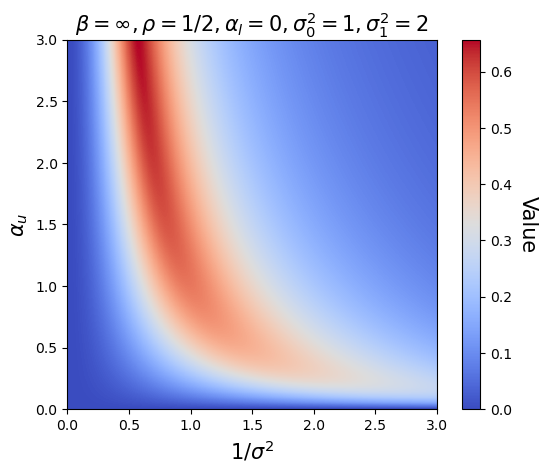

In [49]:
#diff = lu_new_333_n01-lu_new1_333
arr = RSB2

# Set the color map to 'coolwarm' (you can choose any other colormap)
cmap = 'coolwarm'

# Create a figure and axis object
fig, ax = plt.subplots()
#fig, ax = plt.subplots(figsize=(6, 4), dpi=100, subplot_kw=dict(aspect='equal'))
# Create a color-coded representation of the array
im = ax.imshow(arr, cmap=cmap, origin='lower', extent=[0, 3, 0, 3])

# Add a colorbar to the figure
cbar = ax.figure.colorbar(im, ax=ax)

# Set the labels for the colorbar
cbar.ax.set_ylabel('Value', rotation=-90, va="bottom",fontsize=15)
#ax.set_xlim([0, 5])
#ax.set_ylim([0, 5])
# Set the x and y axis labels

plt.title(r'$\beta=\infty,\rho=1/2,\alpha_l=0,\sigma_0^2=1,\sigma_1^2=2$',fontsize=15)
#ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_ylabel(r'$\alpha_u$',fontsize=15)
#plt.grid()
# Show the figure
plt.show()

In [53]:
#phase diagram for seRMLE, alpha_u against SNR(sigma_0^2/sigma^2) ## biased case rho!=0.5
MSE3 = []
RSB3 = []
k3 = []
sig3 = []
chi3 = []

#MSE:
def MMSE(k,sig,s0):
    return ((k-1)**2*s0+sig)/s0

for j in np.arange(0,3.01,0.01):
    mse = []
    rsb = []
    k_t = []
    sig_t = []
    chi_t = []
    for b in np.arange(0.001,3.01,0.01):
        se = seMMSE(0.5,1,1,j,1,b)#fixed rho=0.5,lamb=0.2,alpha_l=0,sigma_0=1
        k_t.append(se[0])
        sig_t.append(se[1])
        chi_t.append(se[3])
        mse.append(MMSE(se[0],se[1],1)) 
        rsb.append(se[4])
  
    MSE3.append(mse)
    RSB3.append(rsb)
    k3.append(k_t)
    sig3.append(sig_t)
    chi3.append(chi_t)

In [56]:
print(MSE3)

[[0.999000999000999, 0.9891196834817013, 0.9794319294809011, 0.9699321047526673, 0.9606147934678194, 0.9514747859181731, 0.942507068803016, 0.9337068160597572, 0.9250693802035153, 0.916590284142988, 0.908265213442325, 0.9000900090009001, 0.8920606601248885, 0.8841732979664014, 0.8764241893076249, 0.8688097306689835, 0.8613264427217916, 0.8539709649871905, 0.846740050804403, 0.8396305625524769, 0.8326394671107411, 0.8257638315441784, 0.8190008190008191, 0.8123476848090982, 0.8058017727639001, 0.7993605115907274, 0.7930214115781128, 0.7867820613690009, 0.78064012490242, 0.774593338497289, 0.7686395080707149, 0.7627765064836003, 0.7570022710068129, 0.7513148009015778, 0.7457121551081283, 0.7401924500370095, 0.7347538574577517, 0.7293946024799416, 0.7241129616220131, 0.7189072609633358, 0.7137758743754461, 0.7087172218284905, 0.7037297677691767, 0.6988120195667367, 0.6939625260235948, 0.6891798759476224, 0.6844626967830254, 0.6798096532970768, 0.675219446320054, 0.670690811535882, 0.666222

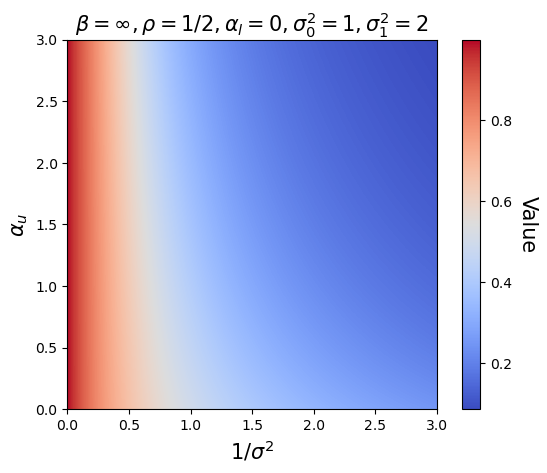

In [65]:
#diff = lu_new_333_n01-lu_new1_333
arr = MSE3

# Set the color map to 'coolwarm' (you can choose any other colormap)
cmap = 'coolwarm'

# Create a figure and axis object
fig, ax = plt.subplots()
#fig, ax = plt.subplots(figsize=(6, 4), dpi=100, subplot_kw=dict(aspect='equal'))
# Create a color-coded representation of the array
im = ax.imshow(arr, cmap=cmap, origin='lower', extent=[0, 3, 0, 3])

# Add a colorbar to the figure
cbar = ax.figure.colorbar(im, ax=ax)

# Set the labels for the colorbar
cbar.ax.set_ylabel('Value', rotation=-90, va="bottom",fontsize=15)
#ax.set_xlim([0, 5])
#ax.set_ylim([0, 5])
# Set the x and y axis labels

plt.title(r'$\beta=\infty,\rho=1/2,\alpha_l=0,\sigma_0^2=1,\sigma_1^2=2$',fontsize=15)
#ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_ylabel(r'$\alpha_u$',fontsize=15)
#plt.grid()
# Show the figure
plt.show()

In [57]:
#phase diagram for seRMLE, alpha_u against SNR(sigma_0^2/sigma^2) ## biased case rho!=0.5 Mismatch
MSE4 = []
RSB4 = []
k4 = []
sig4 = []
chi4 = []

#MSE:
def MMSE(k,sig,s0):
    return ((k-1)**2*s0+sig)/s0

#seMMSE(rho,lamb,alpha_l,alpha_u,sigma_0,b)
for j in np.arange(0,3.01,0.01):
    mse = []
    rsb = []
    k_t = []
    sig_t = []
    chi_t = []
    for b in np.arange(0.001,3.01,0.01):
        se = seMMSE(0.5,2,0,j,1,b)#fixed rho=0.5,lamb=0.2,alpha_l=0,sigma_0=1
        k_t.append(se[0])
        sig_t.append(se[1])
        chi_t.append(se[3])
        mse.append(MMSE(se[0],se[1],1)) 
        rsb.append(se[4])
  
    MSE4.append(mse)
    RSB4.append(rsb)
    k4.append(k_t)
    sig4.append(sig_t)
    chi4.append(chi_t)

In [66]:
print(MSE4)

[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0

In [67]:
print(RSB4)

[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

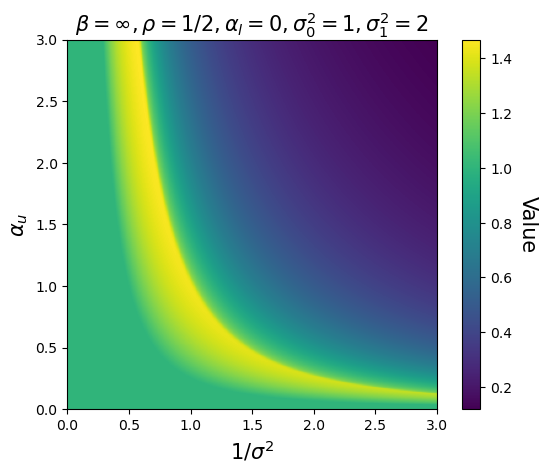

In [63]:
arr = MSE4

cmap = 'viridis'

fig, ax = plt.subplots()

im = ax.imshow(arr, cmap=cmap, origin='lower', extent=[0, 3, 0, 3])

# Add a colorbar to the figure
cbar = ax.figure.colorbar(im, ax=ax)

# Set the labels for the colorbar
cbar.ax.set_ylabel('Value', rotation=-90, va="bottom",fontsize=15)

plt.title(r'$\beta=\infty,\rho=1/2,\alpha_l=0,\sigma_0^2=1,\sigma_1^2=2$',fontsize=15)
#ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_ylabel(r'$\alpha_u$',fontsize=15)
#plt.grid()
# Show the figure
plt.show()

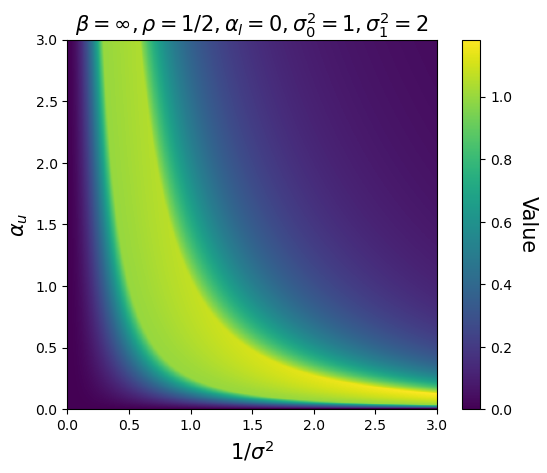

In [68]:
arr = RSB4

cmap = 'viridis'

fig, ax = plt.subplots()

im = ax.imshow(arr, cmap=cmap, origin='lower', extent=[0, 3, 0, 3])

# Add a colorbar to the figure
cbar = ax.figure.colorbar(im, ax=ax)

# Set the labels for the colorbar
cbar.ax.set_ylabel('Value', rotation=-90, va="bottom",fontsize=15)

plt.title(r'$\beta=\infty,\rho=1/2,\alpha_l=0,\sigma_0^2=1,\sigma_1^2=2$',fontsize=15)
#ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_ylabel(r'$\alpha_u$',fontsize=15)
#plt.grid()
# Show the figure
plt.show()

In [96]:
#phase diagram for seRMLE, alpha_u against SNR(sigma_0^2/sigma^2) ## biased case rho!=0.5 Mismatch
MSE5 = []
RSB5 = []
k5 = []
sig5 = []
chi5 = []

#MSE:
def MMSE(k,sig,s0):
    return ((k-1)**2*s0+sig)/s0

#seMMSE(rho,lamb,alpha_l,alpha_u,sigma_0,b)
for j in np.arange(0,3.01,0.01):
    mse = []
    rsb = []
    k_t = []
    sig_t = []
    chi_t = []
    for b in np.arange(0.001,3.01,0.01):
        se = seMMSE(0.5,5,0,j,1,b)#fixed rho=0.5,lamb=0.2,alpha_l=0,sigma_0=1
        k_t.append(se[0])
        sig_t.append(se[1])
        chi_t.append(se[3])
        mse.append(MMSE(se[0],se[1],1)) 
        rsb.append(se[4])
  
    MSE5.append(mse)
    RSB5.append(rsb)
    k5.append(k_t)
    sig5.append(sig_t)
    chi5.append(chi_t)

In [100]:
print(MSE5)

[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0

In [101]:
print(RSB5)

[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

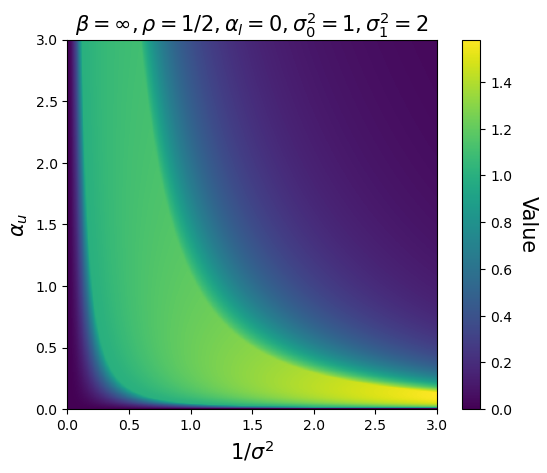

In [106]:
arr = RSB5

cmap = 'viridis'

fig, ax = plt.subplots()

im = ax.imshow(arr, cmap=cmap, origin='lower', extent=[0, 3, 0, 3])

# Add a colorbar to the figure
cbar = ax.figure.colorbar(im, ax=ax)

# Set the labels for the colorbar
cbar.ax.set_ylabel('Value', rotation=-90, va="bottom",fontsize=15)

plt.title(r'$\beta=\infty,\rho=1/2,\alpha_l=0,\sigma_0^2=1,\sigma_1^2=2$',fontsize=15)
#ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_ylabel(r'$\alpha_u$',fontsize=15)
#plt.grid()
# Show the figure
plt.show()

In [107]:
#phase diagram for seRMLE, alpha_u against SNR(sigma_0^2/sigma^2) ## biased case rho!=0.5 Mismatch
MSE6 = []
RSB6 = []
k6 = []
sig6 = []
chi6 = []

#MSE:
def MMSE(k,sig,s0):
    return ((k-1)**2*s0+sig)/s0

#seMMSE(rho,lamb,alpha_l,alpha_u,sigma_0,b)
for j in np.arange(0,3.01,0.01):
    mse = []
    rsb = []
    k_t = []
    sig_t = []
    chi_t = []
    for b in np.arange(0.001,3.01,0.01):
        se = seMMSE(0.5,0.2,0,j,1,b)#fixed rho=0.5,lamb=0.2,alpha_l=0,sigma_0=1
        k_t.append(se[0])
        sig_t.append(se[1])
        chi_t.append(se[3])
        mse.append(MMSE(se[0],se[1],1)) 
        rsb.append(se[4])
  
    MSE6.append(mse)
    RSB6.append(rsb)
    k6.append(k_t)
    sig6.append(sig_t)
    chi6.append(chi_t)

In [108]:
print(MSE6)

[[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0

In [109]:
print(RSB6)

[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

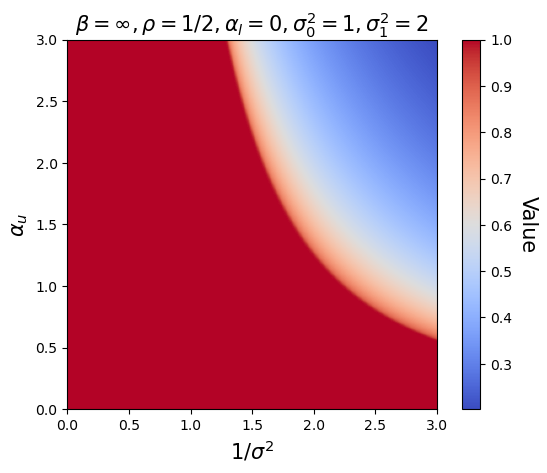

In [112]:
arr = MSE6

cmap = 'coolwarm'

fig, ax = plt.subplots()

im = ax.imshow(arr, cmap=cmap, origin='lower', extent=[0, 3, 0, 3])

# Add a colorbar to the figure
cbar = ax.figure.colorbar(im, ax=ax)

# Set the labels for the colorbar
cbar.ax.set_ylabel('Value', rotation=-90, va="bottom",fontsize=15)

plt.title(r'$\beta=\infty,\rho=1/2,\alpha_l=0,\sigma_0^2=1,\sigma_1^2=2$',fontsize=15)
#ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_ylabel(r'$\alpha_u$',fontsize=15)
#plt.grid()
# Show the figure
plt.show()

In [153]:
#def MMSE(k,sig,s0):#seMMSE(rho,lamb,alpha_l,alpha_u,sigma_0,b)
def seRMLE(rho,lamb,alpha_l,alpha_u,sigma_0,b): #state evolution of RMLE when beta=infty
    k_t = 0.01 #initialized k_t (order parameter)
    chi_t=0.1 #initialized chi_t (order parameter)
    sigma_t2 = 0.1 #initialized sigm_t2 (order parameter)
    eps = 1e-8 #threshold value for unpate order parameters
    parameter_old = np.array([chi_t, k_t, sigma_t2])
    parameter_new = np.array([1, 1, 1])
    iter_se2 = 0 #interation number
    k_collect = [k_t] #collection for k
    sigma2_collect = [sigma_t2] #collection for sigma
    chi_collect = [chi_t] #collection for chi
    rsb_collect = 0
    
    def y_s(p,t): #saddle point method solve for Eq.~(29)
        eps = 1e-12 #epsilon
        y_gst = 1 #initial y^*
        y_pre = 0
        while LA.norm(y_gst-y_pre)>eps:
            y_pre = y_gst
            j = p+np.sqrt(t)*y_pre
            k= -(p+np.sqrt(t)*y_pre)
            y_gst = np.sqrt(t)*(rho*np.exp(j)-(1-rho)*np.exp(k))/(rho*np.exp(j)+(1-rho)*np.exp(k))
        return y_gst

    def F(p, t): #function F Eq.~(30)
        return y_s(p,t)/(np.sqrt(t))

    def T(p, t): #function T Eq.~(31)
        return (1-F(p,t)**2)/(1-t*(1-F(p,t)**2))

    while LA.norm(parameter_new - parameter_old) > eps and iter_se2<1e2:
        parameter_old = np.array([chi_t, k_t, sigma_t2])
        iter_se2 += 1

        z_values = np.arange(-10, 10, 0.1)
        exp_values = np.exp(-1/2 * z_values**2)
        f_values_1 = F(k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values, chi_t*b)
        f_values_2 = F(-k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values, chi_t*b)
        t_values_1 = T(k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values, chi_t*b)
        t_values_2 = T(-k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values, chi_t*b)
        
        sum_t_1 = np.sum(exp_values * t_values_1) / np.sqrt(2 * np.pi) / 10
        sum_t_2 = np.sum(exp_values * t_values_2) / np.sqrt(2 * np.pi) / 10
        
        sum_f_1 = np.sum(exp_values * f_values_1) / np.sqrt(2 * np.pi) / 10
        sum_f_2 = np.sum(exp_values * f_values_2) / np.sqrt(2 * np.pi) / 10
        
        sum_fs_1 = np.sum(exp_values * f_values_1**2) / np.sqrt(2 * np.pi) / 10
        sum_fs_2 = np.sum(exp_values * f_values_2**2) / np.sqrt(2 * np.pi) / 10
        
        chi_new = 1/(1/lamb + b * (alpha_l + alpha_u - alpha_u * (rho*sum_t_1+(1-rho)*sum_t_2))) #SE iter. Eq.~(56a)
        k_new = chi_new * b * (alpha_l + alpha_u * (rho*sum_f_1-(1-rho)*sum_f_2)) #SE iter. Eq.~(56b)
        sigma_new = chi_new**2 * b * (alpha_l + alpha_u * (rho*sum_fs_1+(1-rho)*sum_fs_2)) #SE iter. Eq.~(56c)
        
        parameter_new = np.array([chi_new, k_new, sigma_new])
        
        k_collect.append(k_new)
        sigma2_collect.append(sigma_new)
        chi_collect.append(chi_new)
        
        k_t = k_new
        sigma_t2 = sigma_new
        chi_t = chi_new
    #replica symmtric breaking...    
    z_values = np.arange(-10, 10, 0.1)
    exp_values = np.exp(-1/2 * z_values**2)
    
    t_values_1 = T(k_collect[-1] * sigma_0*b + np.sqrt(k_collect[-1]**2 * sigma_0*b + sigma2_collect[-1]*b) * z_values, chi_collect[-1]*b)
    t_values_2 = T(-k_collect[-1] * sigma_0*b + np.sqrt(k_collect[-1]**2 * sigma_0*b + sigma2_collect[-1]*b) * z_values, chi_collect[-1]*b)
    
    sum_t_rsb_1 = np.sum(exp_values * t_values_1**2) / np.sqrt(2 * np.pi) / 10
    sum_t_rsb_2 = np.sum(exp_values * t_values_2**2) / np.sqrt(2 * np.pi) / 10

    rsb_collect = alpha_u*b**2*chi_collect[-1]**2*(rho*sum_t_rsb_1+(1-rho)*sum_t_rsb_2)
    return k_collect[-1], sigma2_collect[-1], iter_se2, chi_collect[-1], rsb_collect


#def seRMLE(rho,lamb,alpha_l,alpha_u,sigma_0,b):
mmse = []
rmle = []
idx = []
rsb1= []
rsb2= []
for i in np.arange(0.001,3.005,0.005):
    idx.append(i)
    se = seMMSE(0.5,1,0,1,1,i)
    rsb1.append(se[4])
    se1 = seRMLE(0.5,0.33,0,1,1,i)
    rsb2.append(se1[4])
    mmse.append(MMSE(se[0],se[1],1))
    rmle.append(MMSE(se1[0],se1[1],1))

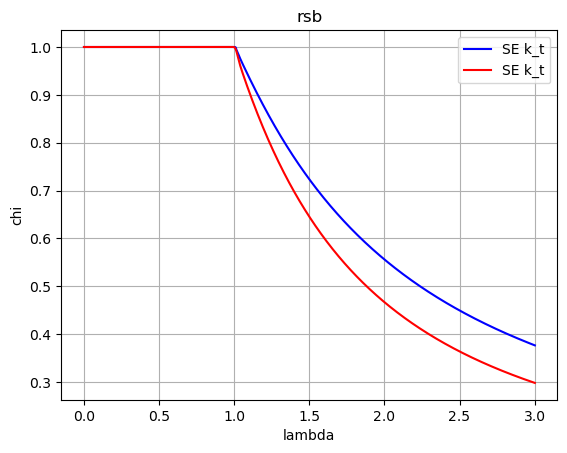

In [154]:
plt.plot(idx,rmle,c="b",label="SE k_t")
plt.plot(idx,mmse,c="r",label="SE k_t")
plt.title("rsb")
plt.ylabel("chi")

plt.xlabel("lambda")
plt.grid()
plt.legend()
plt.show()

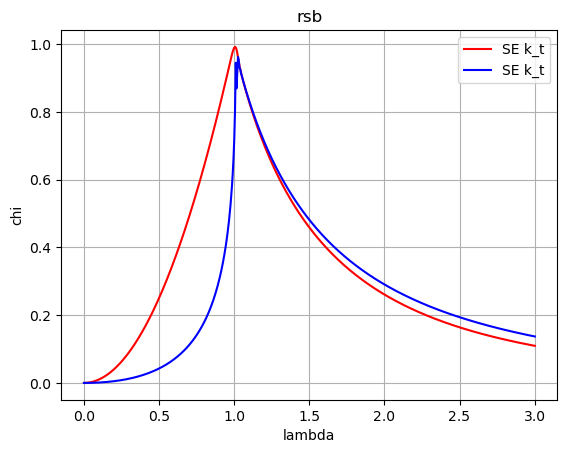

In [176]:
plt.plot(idx,rsb1,c="r",label="SE k_t")
plt.plot(idx,rsb2,c="b",label="SE k_t")
plt.title("rsb")
plt.ylabel("chi")

plt.xlabel("lambda")
plt.grid()
plt.legend()
plt.show()

In [287]:
#rho=1/2, MMSE
def seMMSE_srho(lamb,alpha_l, alpha_u, sigma_0, b):
    sigma2_collect = []
    k_collect = []
    chi_collect = []
    chi_t = 0.1
    k_t = 0.01
    sigma_t2 = 0.1
    eps = 1e-8
    parameter_old = np.array([chi_t, k_t, sigma_t2], dtype=np.float32)
    parameter_new = np.array([1, 1, 1], dtype=np.float32)
    iter_se2 = 0
    k_collect.append(k_t)
    sigma2_collect.append(sigma_t2)
    chi_collect.append(chi_t)
    rsb_collect = 0

    while np.linalg.norm(parameter_new - parameter_old) > eps:
        parameter_old = np.array([chi_t, k_t, sigma_t2])
        iter_se2 += 1

        z_values = np.arange(-10, 10, 0.1)
        exp_values = np.exp(-1/2 * z_values**2)
        tanh_values = np.tanh(k_t * sigma_0 * b + np.sqrt(k_t**2 * sigma_0 * b + sigma_t2 * b) * z_values)
        tanh_squared = tanh_values**2

        sum_1 = np.sum(exp_values * tanh_values) / np.sqrt(2 * np.pi) / 10
        sum_2 = np.sum(exp_values * tanh_squared) / np.sqrt(2 * np.pi) / 10

        chi_new = 1 / (1 / lamb + alpha_l * b + alpha_u * sum_2 * b)
        k_new = chi_new * b * (alpha_l + alpha_u * sum_1)
        sigma_new = chi_new**2 * b * (alpha_l + alpha_u * sum_2)
        parameter_new = np.array([chi_new, k_new, sigma_new])

        chi_collect.append(chi_new)
        k_collect.append(k_new)
        sigma2_collect.append(sigma_new)
        chi_t = chi_new
        k_t = k_new
        sigma_t2 = sigma_new
        
    z_values = np.arange(-10, 10, 0.1)
    exp_values = np.exp(-1/2 * z_values**2)
    tanh_values = np.tanh(k_collect[-1] * sigma_0 * b + np.sqrt(k_collect[-1]**2 * sigma_0 * b + sigma2_collect[-1] * b) * z_values)
    tanh_squared = tanh_values**2
    
    sum_rsb = np.sum(exp_values * (1-tanh_squared)**2 / np.sqrt(2 * np.pi) / 10)
    
    rsb_collect = alpha_u*b**2*chi_collect[-1]**2*sum_rsb
    
    return k_collect[-1], sigma2_collect[-1], iter_se2, chi_collect[-1], rsb_collect

In [405]:
mmse1 = []
mmse2 = []
idx1 = []
rsb3= []
rsb4= []
k1 = []
sig1 = []
chi1 = []
k2 = []
sig2 = []
chi2 = []
for i in np.arange(0.001,3.01,0.01):
    idx1.append(i)
    se = seMMSE_srho(1.5,0,1,1,i)
    k1.append(se[0])
    sig1.append(se[1])
    chi1.append(se[2])
    rsb3.append(se[4])
    se1 = seMMSE_srho(1,0,1,1,i)
    k2.append(se1[0])
    sig2.append(se1[1])
    chi2.append(se1[2])
    rsb4.append(se1[4])
    mmse1.append(MMSE(se[0],se[1],1))
    mmse2.append(MMSE(se1[0],se1[1],1))

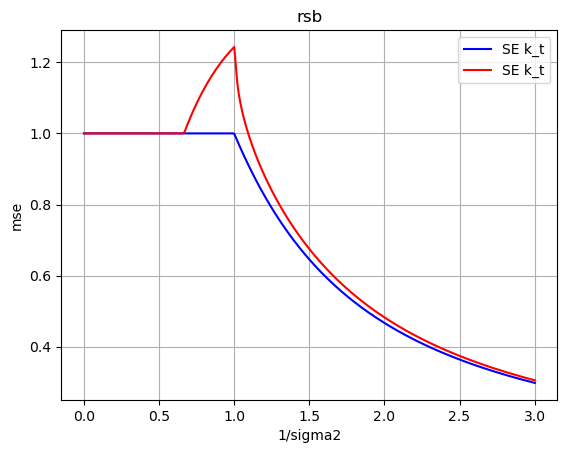

In [411]:
plt.plot(idx1,mmse2,c="b",label="SE k_t")
plt.plot(idx1,mmse1,c="r",label="SE k_t")

#plt.plot(idx1,rsb3,c="navy",label="SE k_t")
#plt.plot(idx1,rsb4,c="brown",label="SE k_t")


plt.title("rsb")
plt.ylabel("mse")

plt.xlabel("1/sigma2")
plt.grid()
plt.legend()
plt.show()

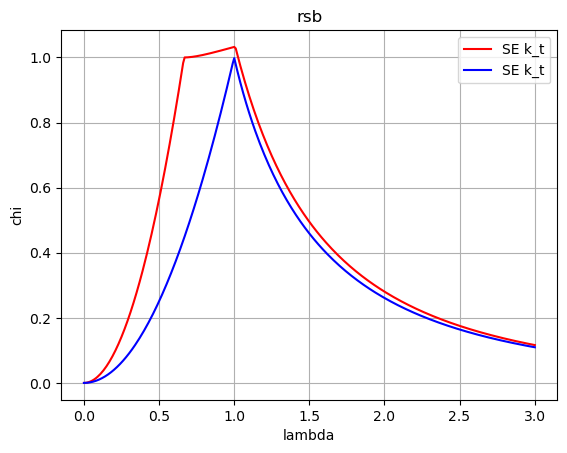

In [407]:
plt.plot(idx1,rsb3,c="r",label="SE k_t")
plt.plot(idx1,rsb4,c="b",label="SE k_t")
plt.title("rsb")
plt.ylabel("chi")

plt.xlabel("lambda")
plt.grid()
plt.legend()
plt.show()

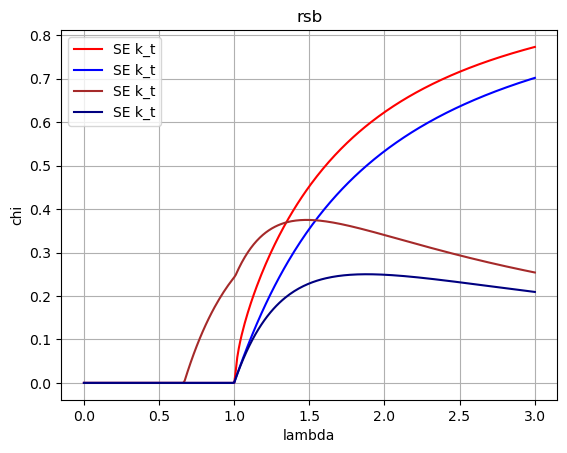

In [413]:
plt.plot(idx1,k1,c="r",label="SE k_t")
plt.plot(idx1,k2,c="b",label="SE k_t")

plt.plot(idx1,sig1,c="brown",label="SE k_t")
plt.plot(idx1,sig2,c="navy",label="SE k_t")
plt.title("rsb")
plt.ylabel("chi")

plt.xlabel("lambda")
plt.grid()
plt.legend()
plt.show()

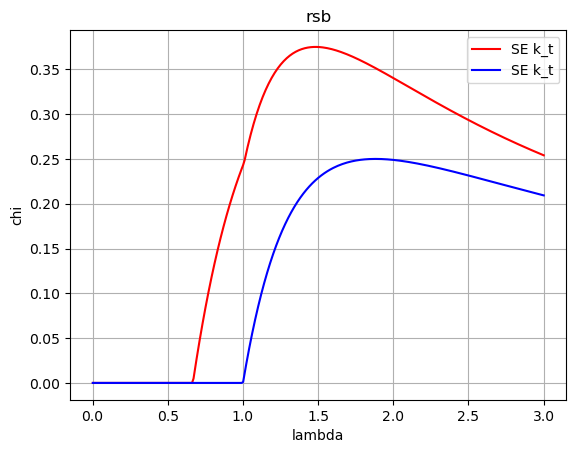

In [409]:
plt.plot(idx1,sig1,c="r",label="SE k_t")
plt.plot(idx1,sig2,c="b",label="SE k_t")
plt.title("rsb")
plt.ylabel("chi")

plt.xlabel("lambda")
plt.grid()
plt.legend()
plt.show()

In [493]:
#def MMSE(k,sig,s0):#seMMSE_srho(lamb,alpha_l,alpha_u,sigma_0,b) rho=0.5
def seRMLE_srho(lamb,alpha_l,alpha_u,sigma_0,b): #state evolution of RMLE when beta=infty
    k_t = 0.01 #initialized k_t (order parameter)
    chi_t=0.1 #initialized chi_t (order parameter)
    sigma_t2 = 0.1 #initialized sigm_t2 (order parameter)
    eps = 1e-8 #threshold value for unpate order parameters
    parameter_old = np.array([chi_t, k_t, sigma_t2])
    parameter_new = np.array([1, 1, 1])
    iter_se2 = 0 #interation number
    k_collect = [k_t] #collection for k
    sigma2_collect = [sigma_t2] #collection for sigma
    chi_collect = [chi_t] #collection for chi
    rsb_collect = 0
    #gamma = 0.15
    def y_s(p,t): #saddle point method solve for Eq.~(29)
        eps = 1e-12 #epsilon
        y_gst = 1 #initial y^*
        y_pre = 0
        while LA.norm(y_gst-y_pre)>eps:
            y_pre = y_gst
            y_gst = np.sqrt(t)*np.tanh(p+np.sqrt(t)*y_pre)
        return y_gst

    def F(p, t): #function F Eq.~(30)
        return y_s(p,t)/(np.sqrt(t))

    def T(p, t): #function T Eq.~(31)
        return (1-F(p,t)**2)/(1-t*(1-F(p,t)**2))

    while LA.norm(parameter_new - parameter_old) > eps and iter_se2<1e2:
        parameter_old = np.array([chi_t, k_t, sigma_t2])
        iter_se2 += 1

        z_values = np.arange(-10, 10, 0.1)
        exp_values = np.exp(-1/2 * z_values**2)
        f_values_1 = F(k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values, chi_t*b)
        t_values_1 = T(k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values, chi_t*b)
        
        sum_t_1 = np.sum(exp_values * t_values_1) / np.sqrt(2 * np.pi) / 10
    
        sum_f_1 = np.sum(exp_values * f_values_1) / np.sqrt(2 * np.pi) / 10
        
        sum_fs_1 = np.sum(exp_values * f_values_1**2) / np.sqrt(2 * np.pi) / 10

        #damping
        #chi_new = gamma*chi_t + (1-gamma)/(1/lamb + b * (alpha_l + alpha_u - alpha_u * sum_t_1)) #SE iter. Eq.~(56a)
        #k_new = gamma*k_t + (1-gamma) * chi_new * b * (alpha_l + alpha_u * sum_f_1) #SE iter. Eq.~(56b)
        #sigma_new = gamma*sigma_t2 + (1-gamma) * chi_new**2 * b * (alpha_l + alpha_u * sum_fs_1) #SE iter. Eq.~(56c)
        chi_new = 1/(1/lamb + b * (alpha_l + alpha_u - alpha_u * sum_t_1)) #SE iter. Eq.~(56a)
        k_new = chi_new * b * (alpha_l + alpha_u * sum_f_1) #SE iter. Eq.~(56b)
        sigma_new = chi_new**2 * b * (alpha_l + alpha_u * sum_fs_1) #SE iter. Eq.~(56c)
        parameter_new = np.array([chi_new, k_new, sigma_new])
        
        k_collect.append(k_new)
        sigma2_collect.append(sigma_new)
        chi_collect.append(chi_new)
        
        k_t = k_new
        sigma_t2 = sigma_new
        chi_t = chi_new
    #replica symmtric breaking...    
    z_values = np.arange(-10, 10, 0.1)
    exp_values = np.exp(-1/2 * z_values**2)
    
    t_values_1 = T(k_collect[-1] * sigma_0*b + np.sqrt(k_collect[-1]**2 * sigma_0*b + sigma2_collect[-1]*b) * z_values, chi_collect[-1]*b)
    
    sum_t_rsb_1 = np.sum(exp_values * t_values_1**2) / np.sqrt(2 * np.pi) / 10

    rsb_collect = alpha_u*b**2*chi_collect[-1]**2*sum_t_rsb_1
    return k_collect[-1], sigma2_collect[-1], iter_se2, chi_collect[-1], rsb_collect

In [494]:
#seRMLE_srho(lamb,alpha_l,alpha_u,sigma_0,b)
mmse1 = []
mmse2 = []
idx1 = []
rsb3= []
rsb4= []
for i in np.arange(0.001,3.01,0.01):
    idx1.append(i)
    se = seMMSE_srho(1,0,1,1,i)
    rsb3.append(se[4])
    se1 = seRMLE_srho(0.33,0,1,1,i)
    rsb4.append(se1[4])
    mmse1.append(MMSE(se[0],se[1],1))
    mmse2.append(MMSE(se1[0],se1[1],1))

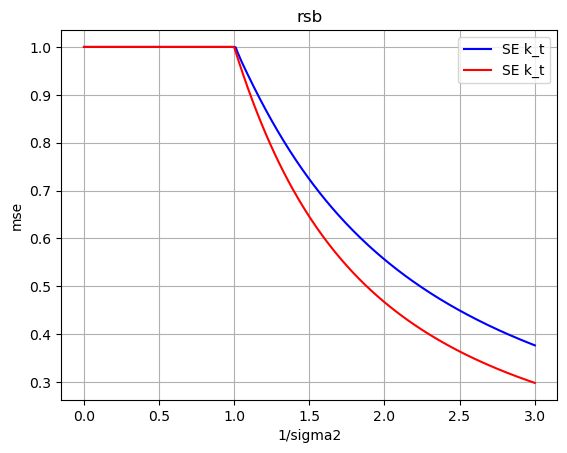

In [495]:
plt.plot(idx1,mmse2,c="b",label="SE k_t")
plt.plot(idx1,mmse1,c="r",label="SE k_t")
plt.title("rsb")
plt.ylabel("mse")

plt.xlabel("1/sigma2")
plt.grid()
plt.legend()
plt.show()

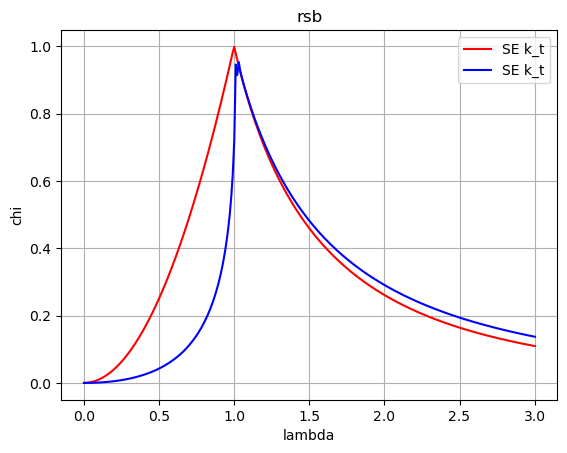

In [496]:
plt.plot(idx1,rsb3,c="r",label="SE k_t")
plt.plot(idx1,rsb4,c="b",label="SE k_t")
plt.title("rsb")
plt.ylabel("chi")

plt.xlabel("lambda")
plt.grid()
plt.legend()
plt.show()

In [447]:
#def MMSE(k,sig,s0):#seMMSE_srho(lamb,alpha_l,alpha_u,sigma_0,b) rho=0.5 fixed chi
def seRMLE_srho_ChiFix(chi,lamb,alpha_l,alpha_u,sigma_0,b): #state evolution of RMLE when beta=infty
    k_t = 0.01 #initialized k_t (order parameter)
    #chi_t=0.1 #initialized chi_t (order parameter)
    sigma_t2 = 0.1 #initialized sigm_t2 (order parameter)
    eps = 1e-8 #threshold value for unpate order parameters
    parameter_old = np.array([k_t, sigma_t2])
    parameter_new = np.array([1, 1])
    iter_se2 = 0 #interation number
    k_collect = [k_t] #collection for k
    sigma2_collect = [sigma_t2] #collection for sigma
    #chi_collect = [chi_t] #collection for chi
    rsb_collect = 0
    
    def y_s(p,t): #saddle point method solve for Eq.~(29)
        eps = 1e-12 #epsilon
        y_gst = 1 #initial y^*
        y_pre = 0
        while LA.norm(y_gst-y_pre)>eps:
            y_pre = y_gst
            y_gst = np.sqrt(t)*np.tanh(p+np.sqrt(t)*y_pre)
        return y_gst

    def F(p, t): #function F Eq.~(30)
        return y_s(p,t)/(np.sqrt(t))

    def T(p, t): #function T Eq.~(31)
        return (1-F(p,t)**2)/(1-t*(1-F(p,t)**2))

    while LA.norm(parameter_new - parameter_old) > eps and iter_se2<1e2:
        parameter_old = np.array([k_t, sigma_t2])
        iter_se2 += 1

        z_values = np.arange(-10, 10, 0.1)
        exp_values = np.exp(-1/2 * z_values**2)
        f_values_1 = F(k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values, chi*b)
    
        sum_f_1 = np.sum(exp_values * f_values_1) / np.sqrt(2 * np.pi) / 10
        
        sum_fs_1 = np.sum(exp_values * f_values_1**2) / np.sqrt(2 * np.pi) / 10
        
        k_new = chi * b * (alpha_l + alpha_u * sum_f_1) #SE iter. Eq.~(56b)
        sigma_new = chi**2 * b * (alpha_l + alpha_u * sum_fs_1) #SE iter. Eq.~(56c)
        
        parameter_new = np.array([k_new, sigma_new])
        
        k_collect.append(k_new)
        sigma2_collect.append(sigma_new)
        #chi_collect.append(chi_new)
        
        k_t = k_new
        sigma_t2 = sigma_new
        #chi_t = chi_new
    #replica symmtric breaking...    
    z_values = np.arange(-10, 10, 0.1)
    exp_values = np.exp(-1/2 * z_values**2)
    
    t_values_1 = T(k_collect[-1] * sigma_0*b + np.sqrt(k_collect[-1]**2 * sigma_0*b + sigma2_collect[-1]*b) * z_values, chi*b)
    
    sum_t_rsb_1 = np.sum(exp_values * t_values_1**2) / np.sqrt(2 * np.pi) / 10

    rsb_collect = alpha_u*b**2*chi**2*sum_t_rsb_1
    return k_collect[-1], sigma2_collect[-1], iter_se2, rsb_collect

In [634]:
USchi_U = []
USalpha_U= []
for chi in np.arange(0.001,1.001,0.001):
    eps=1e-4
    l = 0
    r = 3.5
    m = (l+r)/2
    flag = 0
    while l<=r:
        if seRMLE_srho_ChiFix(chi,1,0,m,1,1)[1]>eps:# and se2(0,m,chi)[2][-1]>eps:
            flag = 1
            r = m-0.001
        else:
            l = m+0.001
        m = (l+r)/2
    if flag:#and se2(0,m,chi)[2][-1]<eps:
        USchi_U.append(chi)
        USalpha_U.append(m)   

In [635]:
print("USchi_U....",USchi_U,"USalpha_U...",USalpha_U)

USchi_U.... [0.223, 0.224, 0.225, 0.226, 0.227, 0.228, 0.229, 0.23, 0.231, 0.232, 0.233, 0.234, 0.23500000000000001, 0.23600000000000002, 0.23700000000000002, 0.23800000000000002, 0.23900000000000002, 0.24000000000000002, 0.241, 0.242, 0.243, 0.244, 0.245, 0.246, 0.247, 0.248, 0.249, 0.25, 0.251, 0.252, 0.253, 0.254, 0.255, 0.256, 0.257, 0.258, 0.259, 0.26, 0.261, 0.262, 0.263, 0.264, 0.265, 0.266, 0.267, 0.268, 0.269, 0.27, 0.271, 0.272, 0.273, 0.274, 0.275, 0.276, 0.277, 0.278, 0.279, 0.28, 0.281, 0.28200000000000003, 0.28300000000000003, 0.28400000000000003, 0.28500000000000003, 0.28600000000000003, 0.28700000000000003, 0.28800000000000003, 0.28900000000000003, 0.29, 0.291, 0.292, 0.293, 0.294, 0.295, 0.296, 0.297, 0.298, 0.299, 0.3, 0.301, 0.302, 0.303, 0.304, 0.305, 0.306, 0.307, 0.308, 0.309, 0.31, 0.311, 0.312, 0.313, 0.314, 0.315, 0.316, 0.317, 0.318, 0.319, 0.32, 0.321, 0.322, 0.323, 0.324, 0.325, 0.326, 0.327, 0.328, 0.329, 0.33, 0.331, 0.332, 0.333, 0.334, 0.335, 0.336, 0.33

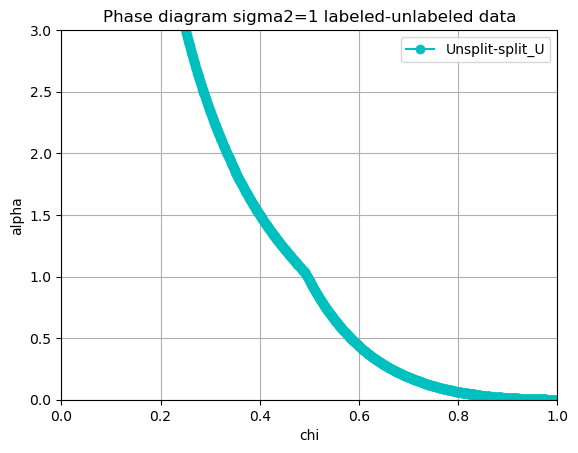

In [636]:
#plt.plot(Split_random_chi_U,Split_random_alpha_U,c="violet",label="Split-random_U",marker="o")    
#plt.plot(Split_random_chi_l2,Split_random_alpha_l2,c="r",label="Split-random_LU",marker="x")   
plt.plot(USchi_U,USalpha_U,c="c",label="Unsplit-split_U",marker="o")
#plt.plot(USchi_l,USalpha_l,c="b",label="Unsplit-split_LU",marker="x")    
#plt.plot(chic,alpc,c="limegreen",label="RSB",marker="o")
#plt.plot(chic_l,alpc_l,c="g",label="RSB_LU",marker="x")
#plt.plot(Unsplit_random_chi,Unsplit_random_alpha,"r-",label="Unsplit-random",linewidth=1)
#plt.plot(Unsplit_split_chi,Unsplit_random_alpha,"b-",label="Unsplit-split",linewidth=1)
plt.title("Phase diagram sigma2=1 labeled-unlabeled data")
plt.ylabel("alpha")
plt.xlabel("chi")
plt.xlim(0,1)
plt.ylim(0,3)
plt.grid()
plt.legend()
plt.show()

In [664]:
USchi_U_l01 = []
USalpha_U_l01= []
for chi in np.arange(0.001,1.001,0.001):
    eps=1e-4
    l = 0
    r = 3.5
    m = (l+r)/2
    flag = 0
    while l<=r:
        if seRMLE_srho_ChiFix(chi,1,0.05,m,1,1)[1]>eps:# and se2(0,m,chi)[2][-1]>eps:
            flag = 1
            r = m-0.001
        else:
            l = m+0.001
        m = (l+r)/2
    if flag:#and se2(0,m,chi)[2][-1]<eps:
        USchi_U_l01.append(chi)
        USalpha_U_l01.append(m)   

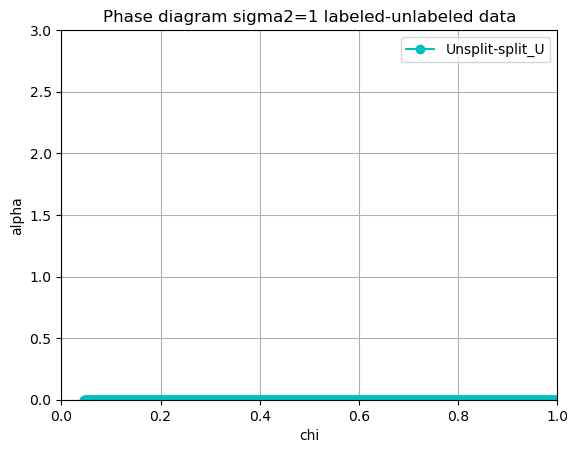

In [665]:
#plt.plot(Split_random_chi_U,Split_random_alpha_U,c="violet",label="Split-random_U",marker="o")    
#plt.plot(Split_random_chi_l2,Split_random_alpha_l2,c="r",label="Split-random_LU",marker="x")   
plt.plot(USchi_U_l01,USalpha_U_l01,c="c",label="Unsplit-split_U",marker="o")
#plt.plot(USchi_l,USalpha_l,c="b",label="Unsplit-split_LU",marker="x")    
#plt.plot(chic,alpc,c="limegreen",label="RSB",marker="o")
#plt.plot(chic_l,alpc_l,c="g",label="RSB_LU",marker="x")
#plt.plot(Unsplit_random_chi,Unsplit_random_alpha,"r-",label="Unsplit-random",linewidth=1)
#plt.plot(Unsplit_split_chi,Unsplit_random_alpha,"b-",label="Unsplit-split",linewidth=1)
plt.title("Phase diagram sigma2=1 labeled-unlabeled data")
plt.ylabel("alpha")
plt.xlabel("chi")
plt.xlim(0,1)
plt.ylim(0,3)
plt.grid()
plt.legend()
plt.show()

In [591]:
alpc = []
chic = []
for i in np.arange(0,3,0.01):
    l = 0
    r = 1
    m = (l+r)/2
    flag=0
    while l<=r:
        if seRMLE_srho_ChiFix(m,1,0,i,1,1)[3]<1:
            l = m+0.01
        else:
            r = m-0.01
            flag=1
        m = (l+r)/2
    if flag ==1:
        alpc.append(i)
        chic.append(m)

In [626]:
RsbCurve_alpha = []
RsbCurve_chi = []
for i in np.arange(0,3.005,0.005):
    l = 0
    r = 1
    m = (l+r)/2
    flag=0
    while l<=r:
        if seRMLE_srho_ChiFix(m,1,0,i,1,1)[3]<1:
            l = m+0.005
        else:
            r = m-0.005
            flag=1
        m = (l+r)/2
    if flag ==1:
        RsbCurve_alpha.append(i)
        RsbCurve_chi.append(m)

In [630]:
print("RsbCurve_chi....",RsbCurve_chi,"RsbCurve_alpha...",RsbCurve_alpha)

RsbCurve_chi.... [0.9379296875, 0.9142578125, 0.8905859375, 0.8748046875, 0.8669140625, 0.8590234374999999, 0.8432421875, 0.8353515624999999, 0.8274609374999999, 0.8195703125, 0.8116796874999999, 0.8037890624999999, 0.8037890624999999, 0.7958984375, 0.7880078124999998, 0.7801171874999999, 0.7801171874999999, 0.7722265625, 0.7722265625, 0.7643359374999998, 0.7564453124999999, 0.7564453124999999, 0.7485546875, 0.7485546875, 0.7406640625, 0.7406640625, 0.7327734374999999, 0.7327734374999999, 0.7327734374999999, 0.7248828125, 0.7248828125, 0.7169921875, 0.7169921875, 0.7091015624999999, 0.7091015624999999, 0.7091015624999999, 0.7012109375, 0.7012109375, 0.7012109375, 0.6933203125, 0.6933203125, 0.6933203125, 0.6854296874999999, 0.6854296874999999, 0.6854296874999999, 0.6775390625, 0.6775390625, 0.6775390625, 0.6775390625, 0.6696484375, 0.6696484375, 0.6696484375, 0.6617578124999999, 0.6617578124999999, 0.6617578124999999, 0.6617578124999999, 0.6538671875, 0.6538671875, 0.6538671875, 0.6538

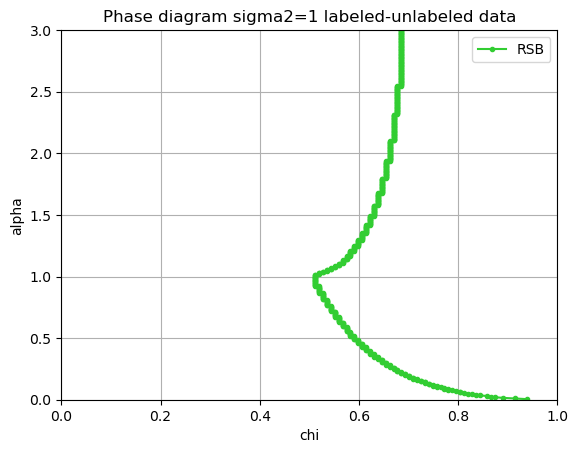

In [629]:
#plt.plot(USchi_U,USalpha_U,c="royalblue",label="Unsplit-split_U",marker="o")
#plt.plot(URchi_U[target:],URalpha_U[target:],c="violet",label="Unsplit-random_U",marker="o")
#plt.plot(USchi_U,USalpha_U,c="b",label="Unsplit-split_U",marker="o")
plt.plot(RsbCurve_chi,RsbCurve_alpha,c="limegreen",label="RSB",marker=".")
#plt.plot(chic_l,alpc_l,c="g",label="RSB_LU",marker="x")
#plt.plot(Unsplit_random_chi,Unsplit_random_alpha,"r-",label="Unsplit-random",linewidth=1)
#plt.plot(Unsplit_split_chi,Unsplit_random_alpha,"b-",label="Unsplit-split",linewidth=1)
plt.title("Phase diagram sigma2=1 labeled-unlabeled data")
plt.ylabel("alpha")
plt.xlabel("chi")
plt.xlim(0,1)
plt.ylim(0,3)
plt.grid()
plt.legend()
plt.show()  

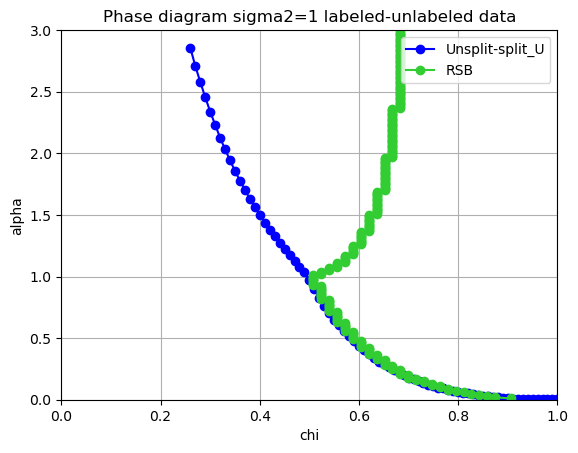

In [592]:
#plt.plot(USchi_U,USalpha_U,c="royalblue",label="Unsplit-split_U",marker="o")
#plt.plot(URchi_U[target:],URalpha_U[target:],c="violet",label="Unsplit-random_U",marker="o")
plt.plot(USchi_U,USalpha_U,c="b",label="Unsplit-split_U",marker="o")
plt.plot(chic,alpc,c="limegreen",label="RSB",marker="o")
#plt.plot(chic_l,alpc_l,c="g",label="RSB_LU",marker="x")
#plt.plot(Unsplit_random_chi,Unsplit_random_alpha,"r-",label="Unsplit-random",linewidth=1)
#plt.plot(Unsplit_split_chi,Unsplit_random_alpha,"b-",label="Unsplit-split",linewidth=1)
plt.title("Phase diagram sigma2=1 labeled-unlabeled data")
plt.ylabel("alpha")
plt.xlabel("chi")
plt.xlim(0,1)
plt.ylim(0,3)
plt.grid()
plt.legend()
plt.show()  

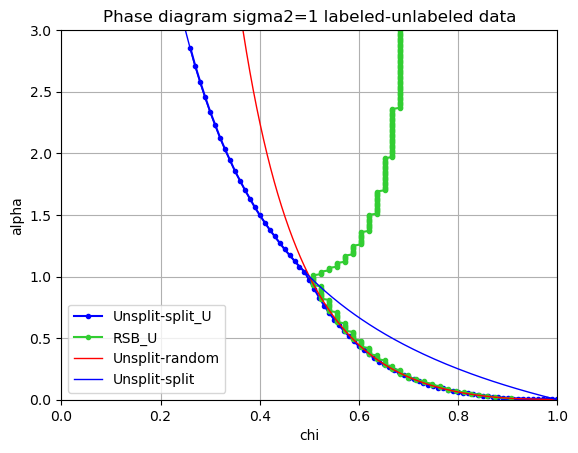

In [593]:
Unsplit_random_alpha = []
Unsplit_random_chi = []
Unsplit_split_chi = []
for i in np.arange(0,3,0.01):
    Unsplit_random_alpha.append(i)
    Unsplit_random_chi.append(1/(1+np.sqrt(i)))
    Unsplit_split_chi.append(1/(1+i))

#plt.plot(U_chi_S[target-1:],U_alpha_S[target-1:],c="violet",label="Split-random_U",marker="o")
#plt.plot(U_chi_R[:target],U_alpha_R[:target],c="b",label="Unsplit-Split_U",marker="o")
#plt.plot(U_chi_R[target-1:],U_alpha_R[target-1:],c="r",label="Unsplit-Random_U",marker="o")
plt.plot(USchi_U,USalpha_U,c="b",label="Unsplit-split_U",marker=".")
plt.plot(chic,alpc,c="limegreen",label="RSB_U",marker=".")
#plt.plot(chic_l,alpc_l,c="g",label="RSB_LU",marker="x")
plt.plot(Unsplit_random_chi,Unsplit_random_alpha,"r-",label="Unsplit-random",linewidth=1)
plt.plot(Unsplit_split_chi,Unsplit_random_alpha,"b-",label="Unsplit-split",linewidth=1)
plt.title("Phase diagram sigma2=1 labeled-unlabeled data")
plt.ylabel("alpha")
plt.xlabel("chi")
plt.xlim(0,1)
plt.ylim(0,3)
plt.grid()
plt.legend()
plt.show() 

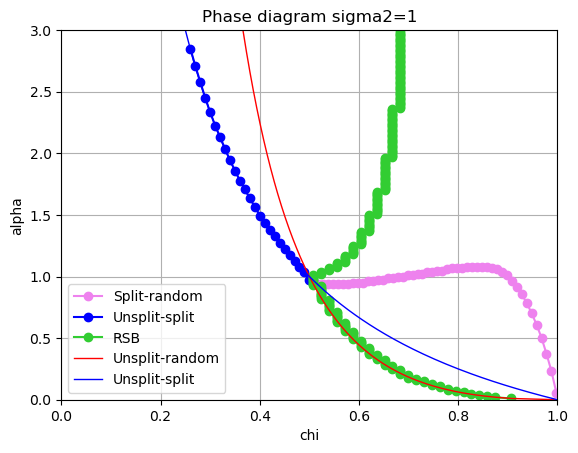

In [606]:
Unsplit_random_alpha = []
Unsplit_random_chi = []
Unsplit_split_chi = []
for i in np.arange(0,3,0.01):
    Unsplit_random_alpha.append(i)
    Unsplit_random_chi.append(1/(1+np.sqrt(i)))
    Unsplit_split_chi.append(1/(1+i))
    
USchi = []
USalpha= []
for chi in np.arange(0.01,min(chic),0.01):
    eps=1e-4
    l = 0
    r = 3
    m = (l+r)/2
    flag = 0
    while l<=r:
        if seRMLE_srho_ChiFix(chi,1,0,m,1,1)[1]>eps:
            flag = 1
            r = m-0.01
        else:
            l = m+0.01
        m = (l+r)/2
    if flag:
        USchi.append(chi)
        USalpha.append(m)
        
Split_random_alpha = []
Split_random_chi = []
for chi in np.arange(min(chic),1,0.01):
    eps=1e-4
    l = 0
    r = 3
    m = (l+r)/2
    flag = 0
    while l<=r:
        if seRMLE_srho_ChiFix(chi,1,0,m,1,1)[0]>eps:
            flag = 1
            r = m-0.01
        else:
            l = m+0.01
        m = (l+r)/2
    if flag:
        Split_random_chi.append(chi)
        Split_random_alpha.append(m)

Split_random_alpha_2 = []
Split_random_chi_2 = []
for chi in np.arange(min(chic),1,0.01):
    eps=1e-4
    l = 0
    r = 3
    m = (l+r)/2
    flag = 0
    while l<=r:
        if seRMLE_srho_ChiFix(chi,1,0,m,1,1)[1]>eps:
            flag = 1
            r = m-0.01
        else:
            l = m+0.01
        m = (l+r)/2
    if flag:
        Split_random_chi_2.append(chi)
        Split_random_alpha_2.append(m)

plt.plot(Split_random_chi,Split_random_alpha,c="violet",label="Split-random",marker="o")        
plt.plot(USchi,USalpha,c="b",label="Unsplit-split",marker="o")    
plt.plot(chic,alpc,c="limegreen",label="RSB",marker="o")
plt.plot(Unsplit_random_chi,Unsplit_random_alpha,"r-",label="Unsplit-random",linewidth=1)
plt.plot(Unsplit_split_chi,Unsplit_random_alpha,"b-",label="Unsplit-split",linewidth=1)
plt.title("Phase diagram sigma2=1")
plt.ylabel("alpha")
plt.xlabel("chi")
plt.xlim(0,1)
plt.ylim(0,3)
plt.grid()
plt.legend()
plt.show()   

In [608]:
Split_random_alpha_2 = []
Split_random_chi_2 = []
for chi in np.arange(min(chic),1,0.01):
    eps=1e-4
    l = 0
    r = 3
    m = (l+r)/2
    flag = 0
    while l<=r:
        if seRMLE_srho_ChiFix(chi,1,0,m,1,1)[1]>eps:
            flag = 1
            r = m-0.01
        else:
            l = m+0.01
        m = (l+r)/2
    if flag:
        Split_random_chi_2.append(chi)
        Split_random_alpha_2.append(m)

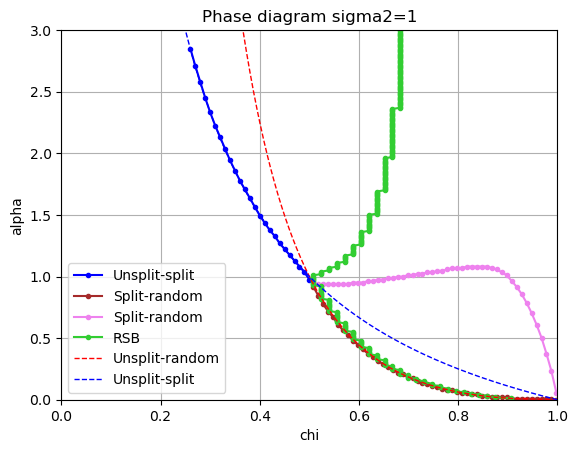

In [623]:
plt.plot(USchi,USalpha,c="b",label="Unsplit-split",marker=".") 
plt.plot(Split_random_chi_2,Split_random_alpha_2,c="brown",label="Split-random",marker=".")
plt.plot(Split_random_chi,Split_random_alpha,c="violet",label="Split-random",marker=".")
plt.plot(chic,alpc,c="limegreen",label="RSB",marker=".")
plt.plot(Unsplit_random_chi,Unsplit_random_alpha,"r--",label="Unsplit-random",linewidth=1)
plt.plot(Unsplit_split_chi,Unsplit_random_alpha,"b--",label="Unsplit-split",linewidth=1)
plt.title("Phase diagram sigma2=1")
plt.ylabel("alpha")
plt.xlabel("chi")
plt.xlim(0,1)
plt.ylim(0,3)
plt.grid()
plt.legend()
plt.show() 

In [619]:
se = seRMLE_srho_ChiFix(0.95,1,0,1,1,1)

In [620]:
se[0]

0.02056785351796252

In [621]:
se[1]

0.6314257054406146

In [622]:
MMSE(se[0],se[1],1)

1.5907130350030259

In [524]:
#seRMLE_srho_ChiFix(chi,lamb,alpha_l,alpha_u,sigma_0,b)
def MMSE(k,sig,s0):
    return ((k-1)**2*s0+sig)/s0
se = seRMLE_srho_ChiFix(0.8,1,0,1.5,1,1)

In [558]:
rmse = []
idx2 = []
for i in np.arange(0.001,1.01,0.01):
    se = seRMLE_srho_ChiFix(i,1,0,1.5,1,1)
    idx2.append(i)
    rmse.append(MMSE(se[0],se[1],1))

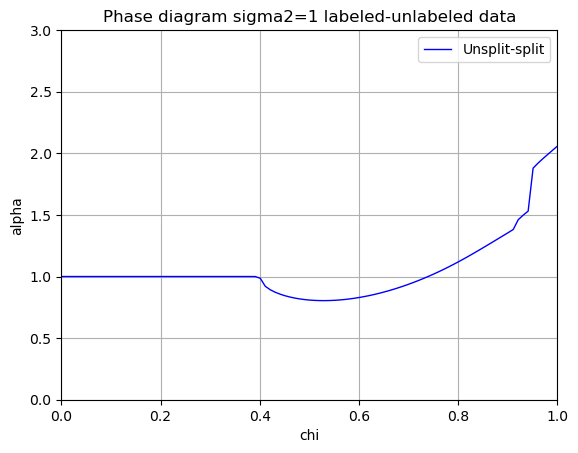

In [559]:
plt.plot(idx2,rmse,"b-",label="Unsplit-split",linewidth=1)
plt.title("Phase diagram sigma2=1 labeled-unlabeled data")
plt.ylabel("alpha")
plt.xlabel("chi")
plt.xlim(0,1)
plt.ylim(0,3)
plt.grid()
plt.legend()
plt.show() 

In [585]:
se = seRMLE_srho_ChiFix(0.29,1,0,2.5,1,1)

In [586]:
se[0]

0.04011498437096389

In [587]:
se[1]

0.0021321888504344795

In [588]:
MMSE(se[0],se[1],1)

0.9235114320795894

In [596]:
#def seRMLE_srho_ChiFix(chi,lamb,alpha_l,alpha_u,sigma_0,b): #state evolution of RMLE when beta=infty
MSE1 = []
RSB1 = []
for j in np.arange(0.001,1,0.05):
    mse=[]
    rsb=[]
    for i in np.arange(0.001,3.05,0.05):
        se = seRMLE_srho_ChiFix(j,1,0,i,1,1)
        mse.append(MMSE(se[0],se[1],1))
        rsb.append(se[3])
    RSB1.append(rsb)
    MSE1.append(mse)

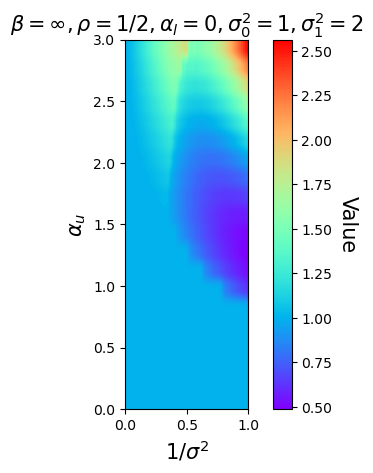

In [599]:
#diff = lu_new_333_n01-lu_new1_333
arr = MSE1

# Set the color map to 'coolwarm' (you can choose any other colormap)
cmap = 'rainbow'

# Create a figure and axis object
fig, ax = plt.subplots()
#fig, ax = plt.subplots(figsize=(6, 4), dpi=100, subplot_kw=dict(aspect='equal'))
# Create a color-coded representation of the array
im = ax.imshow(arr, cmap=cmap, origin='lower', extent=[0, 1, 0, 3])

# Add a colorbar to the figure
cbar = ax.figure.colorbar(im, ax=ax)

# Set the labels for the colorbar
cbar.ax.set_ylabel('Value', rotation=-90, va="bottom",fontsize=15)
#ax.set_xlim([0, 5])
#ax.set_ylim([0, 5])
# Set the x and y axis labels

plt.title(r'$\beta=\infty,\rho=1/2,\alpha_l=0,\sigma_0^2=1,\sigma_1^2=2$',fontsize=15)
#ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_xlabel(r'$1/\sigma^2$',fontsize=15)
ax.set_ylabel(r'$\alpha_u$',fontsize=15)
#plt.grid()
# Show the figure
plt.show()

In [667]:
RsbCurve_alpha_l = []
RsbCurve_chi_l = []
for i in np.arange(0,3.001,0.001):
    l = 0
    r = 1
    m = (l+r)/2
    flag=0
    while l<=r:
        if seRMLE_srho_ChiFix(m,1,0.01,i,1,1)[3]<1:
            l = m+0.001
        else:
            r = m-0.001
            flag=1
        m = (l+r)/2
    if flag ==1:
        RsbCurve_alpha_l.append(i)
        RsbCurve_chi_l.append(m)

In [668]:
print(RsbCurve_alpha_l)

[0.001, 0.002, 0.003, 0.004, 0.005, 0.006, 0.007, 0.008, 0.009000000000000001, 0.01, 0.011, 0.012, 0.013000000000000001, 0.014, 0.015, 0.016, 0.017, 0.018000000000000002, 0.019, 0.02, 0.021, 0.022, 0.023, 0.024, 0.025, 0.026000000000000002, 0.027, 0.028, 0.029, 0.03, 0.031, 0.032, 0.033, 0.034, 0.035, 0.036000000000000004, 0.037, 0.038, 0.039, 0.04, 0.041, 0.042, 0.043000000000000003, 0.044, 0.045, 0.046, 0.047, 0.048, 0.049, 0.05, 0.051000000000000004, 0.052000000000000005, 0.053, 0.054, 0.055, 0.056, 0.057, 0.058, 0.059000000000000004, 0.06, 0.061, 0.062, 0.063, 0.064, 0.065, 0.066, 0.067, 0.068, 0.069, 0.07, 0.07100000000000001, 0.07200000000000001, 0.073, 0.074, 0.075, 0.076, 0.077, 0.078, 0.079, 0.08, 0.081, 0.082, 0.083, 0.084, 0.085, 0.08600000000000001, 0.08700000000000001, 0.088, 0.089, 0.09, 0.091, 0.092, 0.093, 0.094, 0.095, 0.096, 0.097, 0.098, 0.099, 0.1, 0.101, 0.10200000000000001, 0.10300000000000001, 0.10400000000000001, 0.105, 0.106, 0.107, 0.108, 0.109, 0.11, 0.111, 0

In [669]:
print(RsbCurve_chi_l)

[0.994150390625, 0.9921933593750001, 0.990236328125, 0.988279296875, 0.9863222656249999, 0.9863222656249999, 0.984365234375, 0.9824082031249999, 0.9824082031249999, 0.980451171875, 0.980451171875, 0.9784941406250001, 0.9784941406250001, 0.9765371093749999, 0.974580078125, 0.974580078125, 0.9726230468750001, 0.9726230468750001, 0.970666015625, 0.970666015625, 0.9687089843750001, 0.9687089843750001, 0.966751953125, 0.964794921875, 0.964794921875, 0.9628378906249999, 0.9628378906249999, 0.960880859375, 0.9589238281249999, 0.9589238281249999, 0.956966796875, 0.9550097656250001, 0.9550097656250001, 0.9530527343749999, 0.951095703125, 0.951095703125, 0.9491386718750001, 0.947181640625, 0.947181640625, 0.9452246093750001, 0.943267578125, 0.943267578125, 0.941310546875, 0.9393535156249999, 0.9393535156249999, 0.937396484375, 0.9354394531249999, 0.9354394531249999, 0.933482421875, 0.9315253906250001, 0.9315253906250001, 0.9295683593749999, 0.927611328125, 0.927611328125, 0.9256542968750001, 0.9

In [670]:
RsbCurve_alpha_2 = []
RsbCurve_chi_2 = []
for i in np.arange(0,3.001,0.001):
    l = 0
    r = 1
    m = (l+r)/2
    flag=0
    while l<=r:
        if seRMLE_srho_ChiFix(m,1,0.1,i,1,1)[3]<1:
            l = m+0.001
        else:
            r = m-0.001
            flag=1
        m = (l+r)/2
    if flag ==1:
        RsbCurve_alpha_2.append(i)
        RsbCurve_chi_2.append(m)

In [671]:
print(RsbCurve_chi_2)

[0.990236328125, 0.988279296875, 0.9863222656249999, 0.984365234375, 0.984365234375, 0.9824082031249999, 0.9824082031249999, 0.980451171875, 0.980451171875, 0.9784941406250001, 0.9784941406250001, 0.9765371093749999, 0.9765371093749999, 0.9765371093749999, 0.974580078125, 0.974580078125, 0.974580078125, 0.9726230468750001, 0.9726230468750001, 0.9726230468750001, 0.970666015625, 0.970666015625, 0.970666015625, 0.9687089843750001, 0.9687089843750001, 0.9687089843750001, 0.966751953125, 0.966751953125, 0.966751953125, 0.966751953125, 0.964794921875, 0.964794921875, 0.964794921875, 0.964794921875, 0.9628378906249999, 0.9628378906249999, 0.9628378906249999, 0.9628378906249999, 0.960880859375, 0.960880859375, 0.960880859375, 0.960880859375, 0.9589238281249999, 0.9589238281249999, 0.9589238281249999, 0.9589238281249999, 0.956966796875, 0.956966796875, 0.956966796875, 0.956966796875, 0.9550097656250001, 0.9550097656250001, 0.9550097656250001, 0.9550097656250001, 0.9550097656250001, 0.953052734

In [672]:
print(RsbCurve_alpha_2)

[0.003, 0.004, 0.005, 0.006, 0.007, 0.008, 0.009000000000000001, 0.01, 0.011, 0.012, 0.013000000000000001, 0.014, 0.015, 0.016, 0.017, 0.018000000000000002, 0.019, 0.02, 0.021, 0.022, 0.023, 0.024, 0.025, 0.026000000000000002, 0.027, 0.028, 0.029, 0.03, 0.031, 0.032, 0.033, 0.034, 0.035, 0.036000000000000004, 0.037, 0.038, 0.039, 0.04, 0.041, 0.042, 0.043000000000000003, 0.044, 0.045, 0.046, 0.047, 0.048, 0.049, 0.05, 0.051000000000000004, 0.052000000000000005, 0.053, 0.054, 0.055, 0.056, 0.057, 0.058, 0.059000000000000004, 0.06, 0.061, 0.062, 0.063, 0.064, 0.065, 0.066, 0.067, 0.068, 0.069, 0.07, 0.07100000000000001, 0.07200000000000001, 0.073, 0.074, 0.075, 0.076, 0.077, 0.078, 0.079, 0.08, 0.081, 0.082, 0.083, 0.084, 0.085, 0.08600000000000001, 0.08700000000000001, 0.088, 0.089, 0.09, 0.091, 0.092, 0.093, 0.094, 0.095, 0.096, 0.097, 0.098, 0.099, 0.1, 0.101, 0.10200000000000001, 0.10300000000000001, 0.10400000000000001, 0.105, 0.106, 0.107, 0.108, 0.109, 0.11, 0.111, 0.112, 0.113, 0

In [673]:
#def MMSE(k,sig,s0):#seMMSE_srho(lamb,alpha_l,alpha_u,sigma_0,b) fixed chi
def seRMLE_ChiFix(rho,chi,lamb,alpha_l,alpha_u,sigma_0,b): #state evolution of RMLE when beta=infty
    k_t = 0.01 #initialized k_t (order parameter)
    #chi_t=0.1 #initialized chi_t (order parameter)
    sigma_t2 = 0.1 #initialized sigm_t2 (order parameter)
    eps = 1e-8 #threshold value for unpate order parameters
    parameter_old = np.array([k_t, sigma_t2])
    parameter_new = np.array([1, 1])
    iter_se2 = 0 #interation number
    k_collect = [k_t] #collection for k
    sigma2_collect = [sigma_t2] #collection for sigma
    #chi_collect = [chi_t] #collection for chi
    rsb_collect = 0
    
    def y_s(p,t): #saddle point method solve for Eq.~(29)
        eps = 1e-12 #epsilon
        y_gst = 1 #initial y^*
        y_pre = 0
        while LA.norm(y_gst-y_pre)>eps:
            y_pre = y_gst
            j = p+np.sqrt(t)*y_pre
            k= -(p+np.sqrt(t)*y_pre)
            y_gst = np.sqrt(t)*(rho*np.exp(j)-(1-rho)*np.exp(k))/(rho*np.exp(j)+(1-rho)*np.exp(k))
        return y_gst

    def F(p, t): #function F Eq.~(30)
        return y_s(p,t)/(np.sqrt(t))

    def T(p, t): #function T Eq.~(31)
        return (1-F(p,t)**2)/(1-t*(1-F(p,t)**2))

    while LA.norm(parameter_new - parameter_old) > eps and iter_se2<1e2:
        parameter_old = np.array([k_t, sigma_t2])
        iter_se2 += 1

        z_values = np.arange(-10, 10, 0.1)
        exp_values = np.exp(-1/2 * z_values**2)
        f_values_1 = F(k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values, chi*b)
        f_values_2 = F(-k_t * sigma_0*b + np.sqrt(k_t**2 * sigma_0*b + sigma_t2*b) * z_values, chi*b)
        
        sum_f_1 = np.sum(exp_values * f_values_1) / np.sqrt(2 * np.pi) / 10
        sum_f_2 = np.sum(exp_values * f_values_2) / np.sqrt(2 * np.pi) / 10
        
        sum_fs_1 = np.sum(exp_values * f_values_1**2) / np.sqrt(2 * np.pi) / 10
        sum_fs_2 = np.sum(exp_values * f_values_2**2) / np.sqrt(2 * np.pi) / 10
        
        k_new = chi * b * (alpha_l + alpha_u * (rho*sum_f_1 -(1-rho)*sum_f_2)) #SE iter. Eq.~(56b)
        sigma_new = chi**2 * b * (alpha_l + alpha_u * (rho*sum_fs_1+(1-rho)*sum_fs_2)) #SE iter. Eq.~(56c)
        
        parameter_new = np.array([k_new, sigma_new])
        
        k_collect.append(k_new)
        sigma2_collect.append(sigma_new)
        #chi_collect.append(chi_new)
        
        k_t = k_new
        sigma_t2 = sigma_new
        #chi_t = chi_new
    #replica symmtric breaking...    
    z_values = np.arange(-10, 10, 0.1)
    exp_values = np.exp(-1/2 * z_values**2)
    
    t_values_1 = T(k_collect[-1] * sigma_0*b + np.sqrt(k_collect[-1]**2 * sigma_0*b + sigma2_collect[-1]*b) * z_values, chi*b)
    t_values_2 = T(-k_collect[-1] * sigma_0*b + np.sqrt(k_collect[-1]**2 * sigma_0*b + sigma2_collect[-1]*b) * z_values, chi*b)
    
    sum_t_rsb_1 = np.sum(exp_values * t_values_1**2) / np.sqrt(2 * np.pi) / 10
    sum_t_rsb_2 = np.sum(exp_values * t_values_2**2) / np.sqrt(2 * np.pi) / 10

    rsb_collect = alpha_u*b**2*chi**2*(rho*sum_t_rsb_1+(1-rho)*sum_t_rsb_2)

    return k_collect[-1], sigma2_collect[-1], iter_se2, rsb_collect

In [ ]:
RsbCurve_alpha3 = []
RsbCurve_chi3 = []
for i in np.arange(0,3.001,0.001):
    l = 0
    r = 1
    m = (l+r)/2
    flag=0
    while l<=r:
        if seRMLE_ChiFix(0.47,m,1,0,i,1,1)[3]<1:
            l = m+0.001
        else:
            r = m-0.001
            flag=1
        m = (l+r)/2
    if flag ==1:
        RsbCurve_alpha3.append(i)
        RsbCurve_chi3.append(m)